## Assignment 2 
#### In this assingment we will classify your data using k-Nearest Neighbors, decision trees, naive Bayes and support vector machines and interpret the results.

In [287]:
#import the libraries
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import seaborn as sns
import statsmodels.api as sm
from sklearn import linear_model
from statsmodels.formula.api import ols
from sklearn import svm # SVM classifier
from sklearn import neural_network
from sklearn.neural_network import MLPClassifier # MLP classifier
from sklearn import cross_validation # used to test classifier
from sklearn.cross_validation import KFold, cross_val_score, train_test_split
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier 
from sklearn.naive_bayes import MultinomialNB, GaussianNB, BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve # ROC Curves
from sklearn.metrics import auc # Calculating AUC for ROC's!
import warnings
warnings.filterwarnings('ignore')

In [258]:
nasa_data = pd.read_csv('Data/nasa.csv')
nasa_data.head()

,Neo Reference ID,Name,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),...,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,3703080,3703080,21.6,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,...,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,J2000,True
1,3723955,3723955,21.3,0.146068,0.326618,146.067964,326.617897,0.090762,0.202951,479.225620,...,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,J2000,False
2,2446862,2446862,20.3,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,...,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,J2000,True
3,3092506,3092506,27.4,0.008801,0.019681,8.801465,19.680675,0.005469,0.012229,28.876199,...,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,J2000,False
4,3514799,3514799,21.6,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,...,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,J2000,True


In [259]:
#data formating Neo reference ID is a non-informative column
#nasa_data = nasa_data.drop("Neo Reference ID",axis=1)
nasa_data = nasa_data.drop("Name", 1)
nasa_data.head()

,Neo Reference ID,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),...,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,3703080,21.6,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,933.308089,...,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,J2000,True
1,3723955,21.3,0.146068,0.326618,146.067964,326.617897,0.090762,0.202951,479.225620,1071.581063,...,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,J2000,False
2,2446862,20.3,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,1698.341531,...,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,J2000,True
3,3092506,27.4,0.008801,0.019681,8.801465,19.680675,0.005469,0.012229,28.876199,64.569144,...,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,J2000,False
4,3514799,21.6,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,933.308089,...,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,J2000,True


In [261]:
# drop date columns
#nasa_data_clean = nasa_data.drop("Close Approach Date",1)
#nasa_data_clean = nasa_data_clean.drop("Epoch Date Close Approach",1)
#nasa_data_clean = nasa_data_clean.drop("Orbiting Body",1)
#nasa_data_clean = nasa_data_clean.drop("Orbit Determination Date",1)
#nasa_data_clean = nasa_data_clean.drop("Orbit ID",1)
nasa_data_clean.head()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),Relative Velocity km per sec,...,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,21.6,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,933.308089,6.115834,...,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,J2000,True
1,21.3,0.146068,0.326618,146.067964,326.617897,0.090762,0.202951,479.225620,1071.581063,18.113985,...,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,J2000,False
2,20.3,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,1698.341531,7.590711,...,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,J2000,True
3,27.4,0.008801,0.019681,8.801465,19.680675,0.005469,0.012229,28.876199,64.569144,11.173874,...,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,J2000,False
4,21.6,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,933.308089,9.840831,...,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,J2000,True


In [189]:
# Find the classes of the nominal variable Hazardous
categories=nasa_data_clean.Hazardous.unique()
categories

array([True, False], dtype=object)

In [262]:
# count of the values in dataset
nasa_data_clean.groupby('Hazardous').count()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),Relative Velocity km per sec,...,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox
Hazardous,,,,,,,,,,,,,,,,,,,,,
False,3932,3932,3932,3932,3932,3932,3932,3932,3932,3932,...,3932,3932,3932,3932,3932,3932,3932,3932,3932,3932
True,755,755,755,755,755,755,755,755,755,755,...,755,755,755,755,755,755,755,755,755,755


In [263]:
# describe the datset
nasa_data_clean.describe()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),Relative Velocity km per sec,...,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion
count,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,...,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4.687000e+03,4687.000000,4687.000000
mean,22.267865,0.204604,0.457509,204.604203,457.508906,0.127135,0.284283,671.273653,1501.013521,13.970811,...,1.400264,13.373844,172.157275,635.582076,0.813383,183.932151,1.987144,2.457728e+06,181.167927,0.738242
std,2.890972,0.369573,0.826391,369.573402,826.391249,0.229642,0.513496,1212.511199,2711.257465,7.293223,...,0.524154,10.936227,103.276777,370.954727,0.242059,103.513035,0.951519,9.442264e+02,107.501623,0.342627
min,11.160000,0.001011,0.002260,1.010543,2.259644,0.000628,0.001404,3.315431,7.413530,0.335504,...,0.615920,0.014513,0.001941,176.557161,0.080744,0.006918,0.803765,2.450100e+06,0.003191,0.086285
25%,20.100000,0.033462,0.074824,33.462237,74.823838,0.020792,0.046493,109.784247,245.485039,8.432865,...,1.000635,4.962341,83.081208,365.605031,0.630834,95.625916,1.266059,2.457815e+06,87.006918,0.453289
50%,21.900000,0.110804,0.247765,110.803882,247.765013,0.068850,0.153954,363.529809,812.877364,12.917889,...,1.240981,10.311836,172.625393,504.947292,0.833153,189.761641,1.618195,2.457973e+06,185.718889,0.712946
75%,24.500000,0.253837,0.567597,253.837029,567.596853,0.157727,0.352688,832.798679,1862.194459,18.077649,...,1.678364,19.511681,255.026909,794.195972,0.997227,271.777557,2.451171,2.458108e+06,276.531946,0.984669
max,32.100000,15.579552,34.836938,15579.552413,34836.938254,9.680682,21.646663,51114.018738,114294.420501,44.633747,...,5.072008,75.406667,359.905890,4172.231343,1.299832,359.993098,8.983852,2.458839e+06,359.917991,2.039000


In [192]:
# mean of the values in the dataset
nasa_data_clean.groupby('Hazardous').mean()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),Relative Velocity km per sec,...,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion
Hazardous,,,,,,,,,,,,,,,,,,,,,
False,22.680195,0.183161,0.409561,183.161035,409.560525,0.113811,0.254489,600.922050,1343.702553,13.357369,...,1.402737,13.327811,171.363741,637.397269,0.835340,184.107453,1.970134,2.457712e+06,178.616735,0.736287
True,20.120474,0.316279,0.707222,316.279086,707.221537,0.196527,0.439447,1037.661078,2320.280708,17.165585,...,1.387382,13.613582,176.289957,626.128650,0.699034,183.019184,2.075730,2.457810e+06,194.454402,0.748428


In [264]:
# median of the values in the dataset
nasa_data_clean.groupby('Hazardous').median()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),Relative Velocity km per sec,...,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion
Hazardous,,,,,,,,,,,,,,,,,,,,,
False,22.7,0.076658,0.171412,76.657557,171.411509,0.047633,0.106510,251.501180,562.373736,12.29770,...,1.245889,10.426338,172.630064,507.945815,0.858084,189.074521,1.603568,2.457969e+06,182.411752,0.708737
True,20.3,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,1698.341531,15.60769,...,1.225615,9.786674,171.715314,495.597821,0.716482,194.276028,1.709630,2.457994e+06,203.339611,0.726395


In [194]:
# list of the predictors
predictor_names=nasa_data_clean.columns
predictors=predictor_names.tolist()
predictor_names=predictors[:-2]
predictor_names

['Absolute Magnitude',
 'Est Dia in KM(min)',
 'Est Dia in KM(max)',
 'Est Dia in M(min)',
 'Est Dia in M(max)',
 'Est Dia in Miles(min)',
 'Est Dia in Miles(max)',
 'Est Dia in Feet(min)',
 'Est Dia in Feet(max)',
 'Relative Velocity km per sec',
 'Relative Velocity km per hr',
 'Miles per hour',
 'Miss Dist.(Astronomical)',
 'Miss Dist.(lunar)',
 'Miss Dist.(kilometers)',
 'Miss Dist.(miles)',
 'Orbit Uncertainity',
 'Minimum Orbit Intersection',
 'Jupiter Tisserand Invariant',
 'Epoch Osculation',
 'Eccentricity',
 'Semi Major Axis',
 'Inclination',
 'Asc Node Longitude',
 'Orbital Period',
 'Perihelion Distance',
 'Perihelion Arg',
 'Aphelion Dist',
 'Perihelion Time',
 'Mean Anomaly',
 'Mean Motion']

In [265]:
# rank of the predictors on the basis of their median values
def rank_predictors(dat,l,f='Hazardous'):
    rank={}
    max_vals=dat.max()
    median_vals=dat.groupby(f).median()  # We are using the median as the mean is sensitive to outliers
    for p in l:
        score=np.abs((median_vals[p][False]-median_vals[p][True])/max_vals[p])
        rank[p]=score
    return rank
cat_rank=rank_predictors(nasa_data_clean,predictor_names) 
cat_rank

{'Absolute Magnitude': 0.074766355140186869,
 'Aphelion Dist': 0.011805885297408437,
 'Asc Node Longitude': 0.0025416388111127318,
 'Eccentricity': 0.099287801480649709,
 'Epoch Osculation': 0.0,
 'Est Dia in Feet(max)': 0.0099389610660559954,
 'Est Dia in Feet(min)': 0.0099389610660542867,
 'Est Dia in KM(max)': 0.0099389610670003146,
 'Est Dia in KM(min)': 0.0099389610623718087,
 'Est Dia in M(max)': 0.0099389610660578186,
 'Est Dia in M(min)': 0.0099389610660541982,
 'Est Dia in Miles(max)': 0.0099389610681218637,
 'Est Dia in Miles(min)': 0.0099389610650161535,
 'Inclination': 0.0084828663237172738,
 'Jupiter Tisserand Invariant': 0.003601108033240871,
 'Mean Anomaly': 0.058146187931920376,
 'Mean Motion': 0.0086603392011135368,
 'Miles per hour': 0.074158894711191831,
 'Minimum Orbit Intersection': 0.086407046795189679,
 'Miss Dist.(Astronomical)': 0.036734886463007717,
 'Miss Dist.(kilometers)': 0.036734892005520076,
 'Miss Dist.(lunar)': 0.036734871875061782,
 'Miss Dist.(miles)

In [266]:
# sort the ranking of the items in the list of categories
cat_rank=sorted(cat_rank.items(), key=lambda x: x[1])
cat_rank

[('Epoch Osculation', 0.0),
 ('Perihelion Time', 1.0131801380505074e-05),
 ('Asc Node Longitude', 0.0025416388111127318),
 ('Orbital Period', 0.0029595660164040295),
 ('Jupiter Tisserand Invariant', 0.003601108033240871),
 ('Semi Major Axis', 0.0039972594341925174),
 ('Inclination', 0.0084828663237172738),
 ('Mean Motion', 0.0086603392011135368),
 ('Est Dia in KM(min)', 0.0099389610623718087),
 ('Est Dia in Miles(min)', 0.0099389610650161535),
 ('Est Dia in M(min)', 0.0099389610660541982),
 ('Est Dia in Feet(min)', 0.0099389610660542867),
 ('Est Dia in Feet(max)', 0.0099389610660559954),
 ('Est Dia in M(max)', 0.0099389610660578186),
 ('Est Dia in KM(max)', 0.0099389610670003146),
 ('Est Dia in Miles(max)', 0.0099389610681218637),
 ('Aphelion Dist', 0.011805885297408437),
 ('Perihelion Arg', 0.014448906635205117),
 ('Miss Dist.(lunar)', 0.036734871875061782),
 ('Miss Dist.(Astronomical)', 0.036734886463007717),
 ('Miss Dist.(miles)', 0.036734890373694679),
 ('Miss Dist.(kilometers)', 0

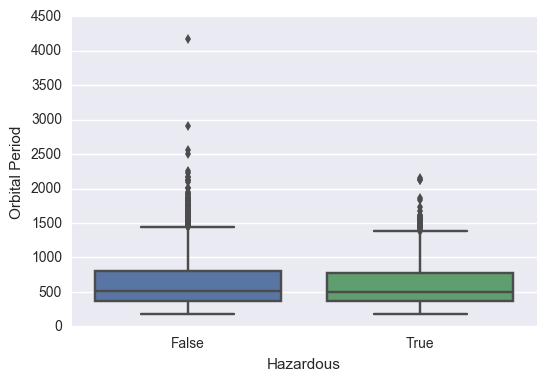

In [268]:
# box plots for the orbital period
sns.boxplot(x='Hazardous', y='Orbital Period', data=nasa_data_clean)

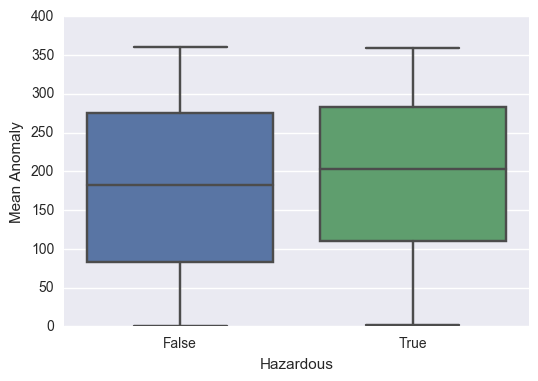

In [198]:
# Box plot for the mean anomaly 
sns.boxplot(x='Hazardous', y='Mean Anomaly', data=nasa_data_clean)

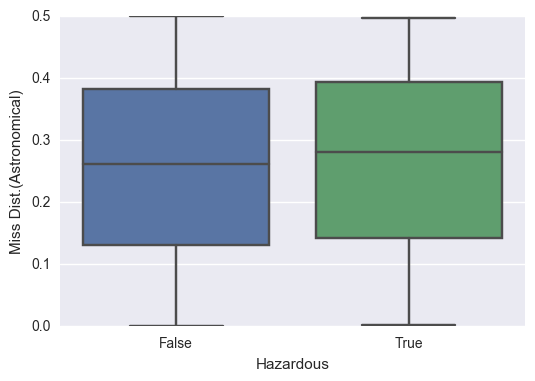

In [199]:
# Box plot for the miss dist
sns.boxplot(x='Hazardous', y='Miss Dist.(Astronomical)', data=nasa_data_clean)

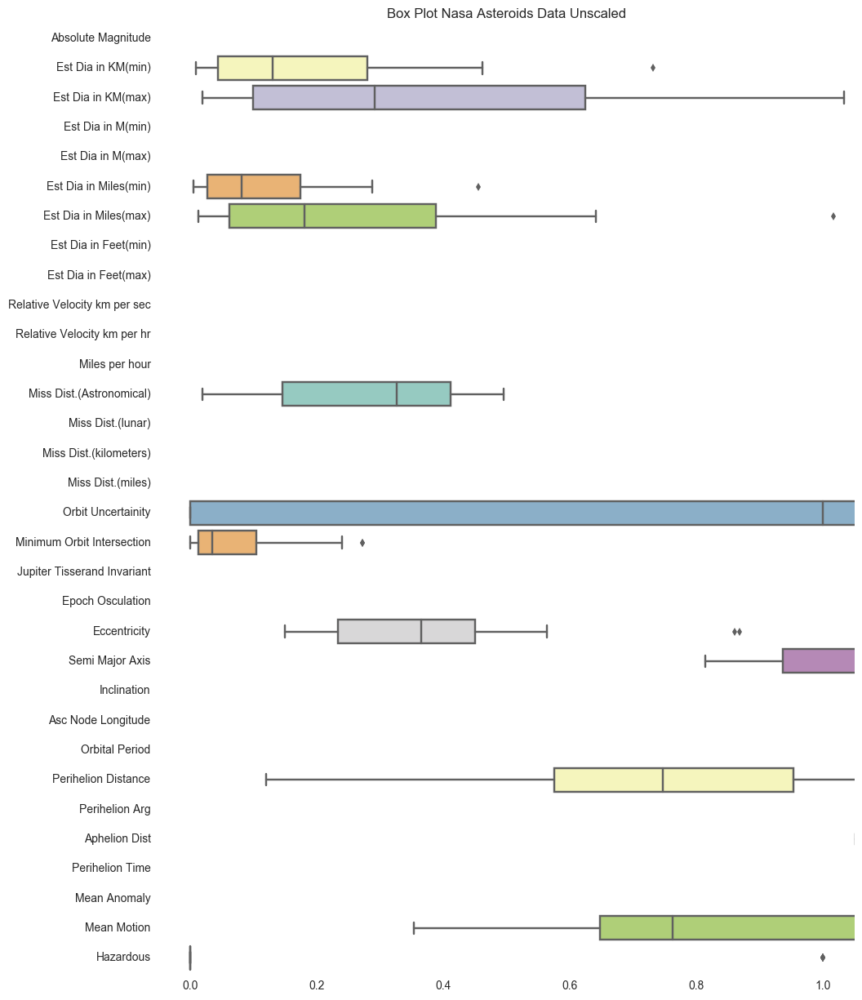

In [200]:
# unscaled box plots
f, ax = plt.subplots(figsize=(11, 15))
ax.set_axis_bgcolor('#FFFFFF')
plt.title("Box Plot Nasa Asteroids Data Unscaled")
ax.set(xlim=(-.05, 1.05))
ax = sns.boxplot(data = nasa_data_clean[1:29], 
  orient = 'h', 
  palette = 'Set3')

#### Note: Not all analysis are sensitive scaling but many that depend on distance metrics are. As we are going apply many algorithms to the data and compare them. Let's scale the data so all analysis use the same data.

In [201]:
# scaling of the data by taking the difference between max and min values
def scaled_df(df):
    scaled = pd.DataFrame()
    for item in df:
        if item in df.select_dtypes(include=[np.float]):
            scaled[item] = ((df[item] - df[item].min()) / 
            (df[item].max() - df[item].min()))
        else: 
            scaled[item] = df[item]
    return scaled
nasa_data_scaled = scaled_df(nasa_data_clean)

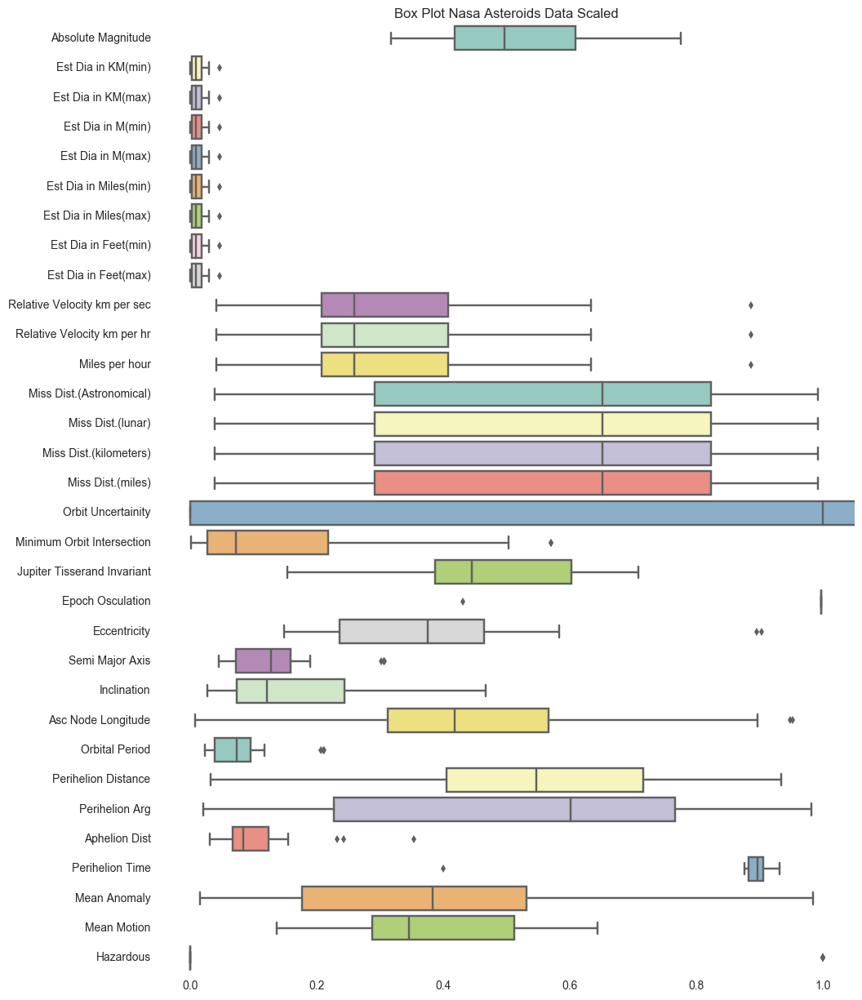

In [202]:
# scaled box plot
f, ax = plt.subplots(figsize=(11, 15))
ax.set_axis_bgcolor('#FFFFFF')
plt.title("Box Plot Nasa Asteroids Data Scaled")
ax.set(xlim=(-.05, 1.05))
ax = sns.boxplot(data = nasa_data_scaled[1:29], 
  orient = 'h', 
  palette = 'Set3')

In [208]:
# Take the top predictors based on median difference
ranked_predictors=[]
for f in cat_rank[21:]:
    ranked_predictors.append(f[0])
ranked_predictors

['Miss Dist.(kilometers)',
 'Mean Anomaly',
 'Relative Velocity km per sec',
 'Miles per hour',
 'Relative Velocity km per hr',
 'Absolute Magnitude',
 'Minimum Orbit Intersection',
 'Eccentricity',
 'Perihelion Distance',
 'Orbit Uncertainity']

# Random Forest Classifier

In [209]:
X = nasa_data_scaled[predictor_names]
#setting target
y = nasa_data_scaled["Hazardous"]

In [210]:
RFm = RandomForestClassifier(random_state = 42, 
                                criterion='gini',
                                n_estimators = 500,
                                max_features = 5)

In [211]:
RFm.fit(X,y)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features=5, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=500, n_jobs=1,
            oob_score=False, random_state=42, verbose=0, warm_start=False)

In [212]:
high_info_gain = RFm.feature_importances_
index_ig = np.argsort(high_info_gain)[::-1]
index_ig

array([17,  6, 25, 22,  4,  8,  7,  1,  2,  0,  3,  5, 13, 12, 15, 14, 26,
       27, 16, 20, 30, 24, 10, 18, 21,  9, 11, 29, 28, 23, 19])

In [214]:
# Print the feature ranking
print("Feature ranking:")
ranked_predictors_RF=[]
for f in range(len(predictor_names)):
    i = f
    if i < len(ranked_predictors):
        ranked_predictors_RF.append(predictor_names[index_ig[i]])  
    print("%d. The feature '%s' \
    has a Information Gain of %f" % (f + 1,
                predictor_names[index_ig[i]],
                high_info_gain[index_ig[f]]))

Feature ranking:
1. The feature 'Minimum Orbit Intersection'     has a Information Gain of 0.473990
2. The feature 'Est Dia in Miles(max)'     has a Information Gain of 0.042782
3. The feature 'Perihelion Distance'     has a Information Gain of 0.040886
4. The feature 'Inclination'     has a Information Gain of 0.038992
5. The feature 'Est Dia in M(max)'     has a Information Gain of 0.038541
6. The feature 'Est Dia in Feet(max)'     has a Information Gain of 0.037009
7. The feature 'Est Dia in Feet(min)'     has a Information Gain of 0.034750
8. The feature 'Est Dia in KM(min)'     has a Information Gain of 0.033801
9. The feature 'Est Dia in KM(max)'     has a Information Gain of 0.032340
10. The feature 'Absolute Magnitude'     has a Information Gain of 0.030450
11. The feature 'Est Dia in M(min)'     has a Information Gain of 0.027576
12. The feature 'Est Dia in Miles(min)'     has a Information Gain of 0.022127
13. The feature 'Miss Dist.(lunar)'     has a Information Gain of 0.01

In [215]:
print (ranked_predictors)
print (ranked_predictors_RF)

['Miss Dist.(kilometers)', 'Mean Anomaly', 'Relative Velocity km per sec', 'Miles per hour', 'Relative Velocity km per hr', 'Absolute Magnitude', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance', 'Orbit Uncertainity']
['Minimum Orbit Intersection', 'Est Dia in Miles(max)', 'Perihelion Distance', 'Inclination', 'Est Dia in M(max)', 'Est Dia in Feet(max)', 'Est Dia in Feet(min)', 'Est Dia in KM(min)', 'Est Dia in KM(max)', 'Absolute Magnitude']


In [216]:
# Lets combine the Random Forest and median difference rankings.
# Note that they are largely in agreement as only 2 were added to the original list of 12
for p in ranked_predictors_RF:
    if p not in ranked_predictors:
        ranked_predictors.append(p)
print (ranked_predictors)
print (len(ranked_predictors))

['Miss Dist.(kilometers)', 'Mean Anomaly', 'Relative Velocity km per sec', 'Miles per hour', 'Relative Velocity km per hr', 'Absolute Magnitude', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance', 'Orbit Uncertainity', 'Est Dia in Miles(max)', 'Inclination', 'Est Dia in M(max)', 'Est Dia in Feet(max)', 'Est Dia in Feet(min)', 'Est Dia in KM(min)', 'Est Dia in KM(max)']
17


In [223]:
print (ranked_predictors)
i=['Hazardous']
#ranked_predictors
i=i+ranked_predictors
print (i)
nasa_data_ranked=nasa_data_scaled[i]
# convert diagnosis to a numeric variable to create a numeric dependent variable
nasa_data_ranked['Hazardous'] = nasa_data_ranked.Hazardous.map({False:0, True:1})
nasa_data_ranked.head()

['Miss Dist.(kilometers)', 'Mean Anomaly', 'Relative Velocity km per sec', 'Miles per hour', 'Relative Velocity km per hr', 'Absolute Magnitude', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance', 'Orbit Uncertainity', 'Est Dia in Miles(max)', 'Inclination', 'Est Dia in M(max)', 'Est Dia in Feet(max)', 'Est Dia in Feet(min)', 'Est Dia in KM(min)', 'Est Dia in KM(max)']
['Hazardous', 'Miss Dist.(kilometers)', 'Mean Anomaly', 'Relative Velocity km per sec', 'Miles per hour', 'Relative Velocity km per hr', 'Absolute Magnitude', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance', 'Orbit Uncertainity', 'Est Dia in Miles(max)', 'Inclination', 'Est Dia in M(max)', 'Est Dia in Feet(max)', 'Est Dia in Feet(min)', 'Est Dia in KM(min)', 'Est Dia in KM(max)']


,Hazardous,Miss Dist.(kilometers),Mean Anomaly,Relative Velocity km per sec,Miles per hour,Relative Velocity km per hr,Absolute Magnitude,Minimum Orbit Intersection,Eccentricity,Perihelion Distance,Orbit Uncertainity,Est Dia in Miles(max),Inclination,Est Dia in M(max),Est Dia in Feet(max),Est Dia in Feet(min),Est Dia in KM(min),Est Dia in KM(max)
0,1,0.839102,0.735825,0.130487,0.130487,0.130487,0.498567,0.052899,0.438763,0.596770,5,0.008101,0.079736,0.008101,0.008101,0.008101,0.008101,0.008101
1,0,0.766123,0.482720,0.401336,0.401336,0.401336,0.484241,0.391164,0.361224,0.522896,3,0.009311,0.376677,0.009311,0.009311,0.009311,0.009311,0.009311
2,1,0.101616,0.813777,0.163781,0.163781,0.163781,0.436485,0.090096,0.357628,0.713687,0,0.014795,0.056020,0.014795,0.014795,0.014795,0.014795,0.014795
3,0,0.570624,0.190984,0.244668,0.244668,0.244668,0.775549,0.011529,0.219426,0.740847,6,0.000500,0.104671,0.000500,0.000500,0.000500,0.000500,0.000500
4,1,0.815788,0.375475,0.214576,0.214576,0.214576,0.498567,0.072812,0.212992,0.727546,1,0.008101,0.222555,0.008101,0.008101,0.008101,0.008101,0.008101


In [229]:
features_mean=list(nasa_data_ranked.columns[1:])
# split dataframe into two based on diagnosis
nasa_data_rankedT=nasa_data_ranked[nasa_data_ranked['Hazardous'] ==1]
nasa_data_rankedF=nasa_data_ranked[nasa_data_ranked['Hazardous'] ==0]

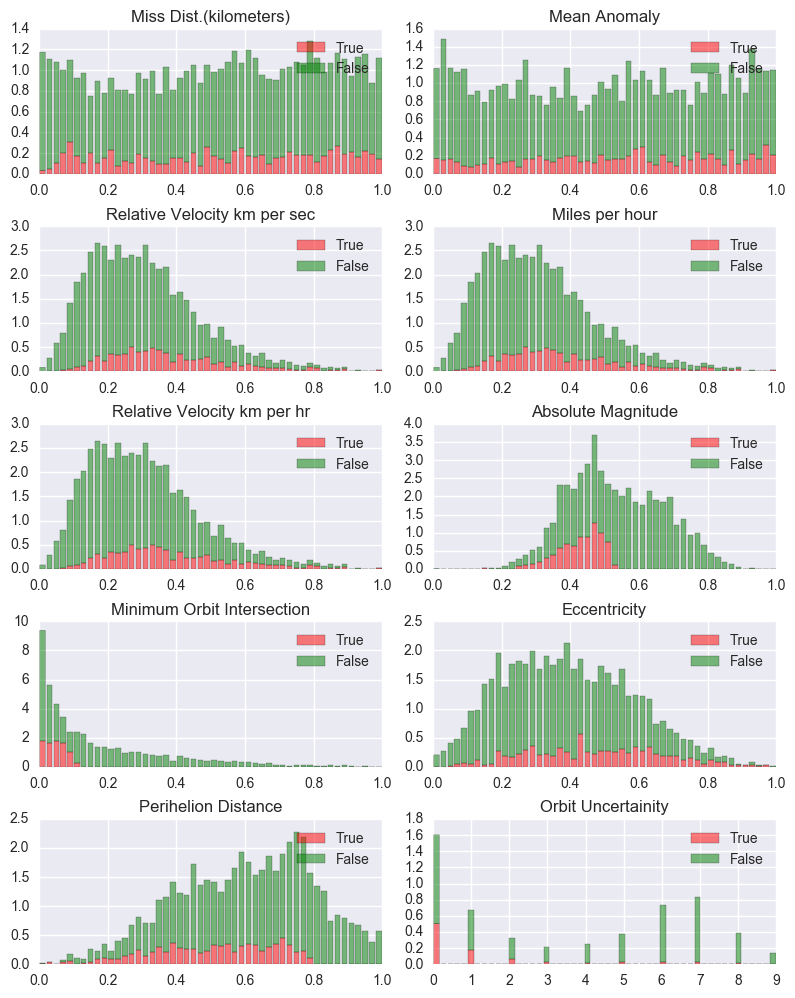

In [233]:
#Stack the data
plt.rcParams.update({'font.size': 8})
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(8,10))
axes = axes.ravel()
for idx,ax in enumerate(axes):
    ax.figure
    binwidth= (max(nasa_data_ranked[features_mean[idx]]) - min(nasa_data_ranked[features_mean[idx]]))/50
    ax.hist([nasa_data_rankedT[features_mean[idx]],nasa_data_rankedF[features_mean[idx]]], bins=np.arange(min(nasa_data_ranked[features_mean[idx]]), max(nasa_data_ranked[features_mean[idx]]) + binwidth, binwidth) , alpha=0.5,stacked=True, normed = True, label=[True,False],color=['r','g'])
    ax.legend(loc='upper right')
    ax.set_title(features_mean[idx])
plt.tight_layout()
plt.show()

In [234]:
nasa_data_ranked.corr()

,Hazardous,Miss Dist.(kilometers),Mean Anomaly,Relative Velocity km per sec,Miles per hour,Relative Velocity km per hr,Absolute Magnitude,Minimum Orbit Intersection,Eccentricity,Perihelion Distance,Orbit Uncertainity,Est Dia in Miles(max),Inclination,Est Dia in M(max),Est Dia in Feet(max),Est Dia in Feet(min),Est Dia in KM(min),Est Dia in KM(max)
Hazardous,1.000000,0.032407,0.054164,0.191970,0.191970,0.191970,-0.325522,-0.288949,0.183269,-0.207027,-0.328721,0.132424,0.009607,0.132424,0.132424,0.132424,0.132424,0.132424
Miss Dist.(kilometers),0.032407,1.000000,-0.010157,0.351694,0.351694,0.351694,-0.339117,0.351981,-0.005627,-0.079937,-0.326158,0.188027,0.255828,0.188027,0.188027,0.188027,0.188027,0.188027
Mean Anomaly,0.054164,-0.010157,1.000000,0.017685,0.017685,0.017685,-0.049401,-0.013336,0.026161,-0.047114,-0.059396,0.031455,0.015743,0.031455,0.031455,0.031455,0.031455,0.031455
Relative Velocity km per sec,0.191970,0.351694,0.017685,1.000000,1.000000,1.000000,-0.376853,0.076306,0.495053,-0.506978,-0.202234,0.242141,0.514657,0.242141,0.242141,0.242141,0.242141,0.242141
Miles per hour,0.191970,0.351694,0.017685,1.000000,1.000000,1.000000,-0.376853,0.076306,0.495053,-0.506978,-0.202234,0.242141,0.514657,0.242141,0.242141,0.242141,0.242141,0.242141
Relative Velocity km per hr,0.191970,0.351694,0.017685,1.000000,1.000000,1.000000,-0.376853,0.076306,0.495053,-0.506978,-0.202234,0.242141,0.514657,0.242141,0.242141,0.242141,0.242141,0.242141
Absolute Magnitude,-0.325522,-0.339117,-0.049401,-0.376853,-0.376853,-0.376853,1.000000,-0.488235,-0.361359,0.086966,0.677764,-0.613482,-0.459632,-0.613482,-0.613482,-0.613482,-0.613482,-0.613482
Minimum Orbit Intersection,-0.288949,0.351981,-0.013336,0.076306,0.076306,0.076306,-0.488235,1.000000,0.093795,0.299991,-0.267524,0.257904,0.439867,0.257904,0.257904,0.257904,0.257904,0.257904
Eccentricity,0.183269,-0.005627,0.026161,0.495053,0.495053,0.495053,-0.361359,0.093795,1.000000,-0.412612,-0.088029,0.216623,0.039018,0.216623,0.216623,0.216623,0.216623,0.216623
Perihelion Distance,-0.207027,-0.079937,-0.047114,-0.506978,-0.506978,-0.506978,0.086966,0.299991,-0.412612,1.000000,0.107946,-0.071866,-0.046215,-0.071866,-0.071866,-0.071866,-0.071866,-0.071866


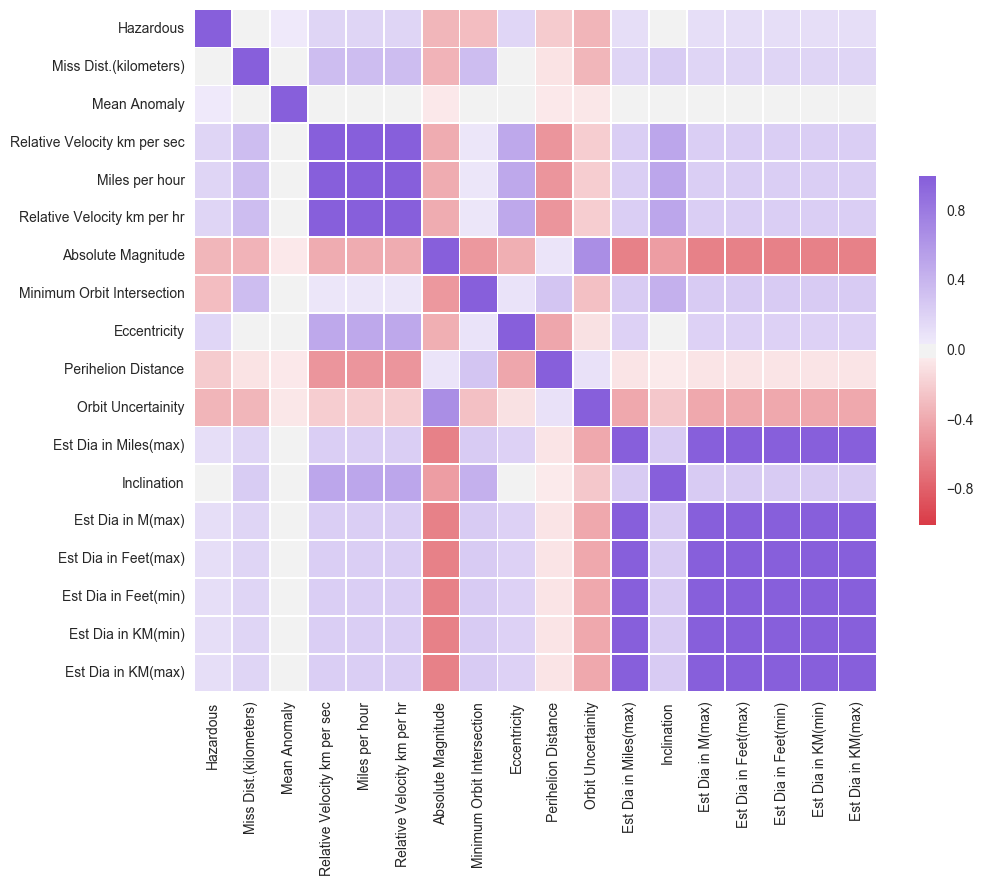

In [235]:
corr = nasa_data_ranked.corr(method = 'pearson') # Correlation Matrix

f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(10, 275, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr,  cmap=cmap,square=True, 
            xticklabels=True, yticklabels=True,
            linewidths=.5, cbar_kws={"shrink": .5}, ax=ax)

Hazardous                       1.000000
Miss Dist.(kilometers)          0.032407
Mean Anomaly                    0.054164
Relative Velocity km per sec    0.191970
Miles per hour                  0.191970
Relative Velocity km per hr     0.191970
Absolute Magnitude             -0.325522
Minimum Orbit Intersection     -0.288949
Eccentricity                    0.183269
Perihelion Distance            -0.207027
Orbit Uncertainity             -0.328721
Est Dia in Miles(max)           0.132424
Inclination                     0.009607
Est Dia in M(max)               0.132424
Est Dia in Feet(max)            0.132424
Est Dia in Feet(min)            0.132424
Est Dia in KM(min)              0.132424
Est Dia in KM(max)              0.132424
Name: Hazardous, dtype: float64

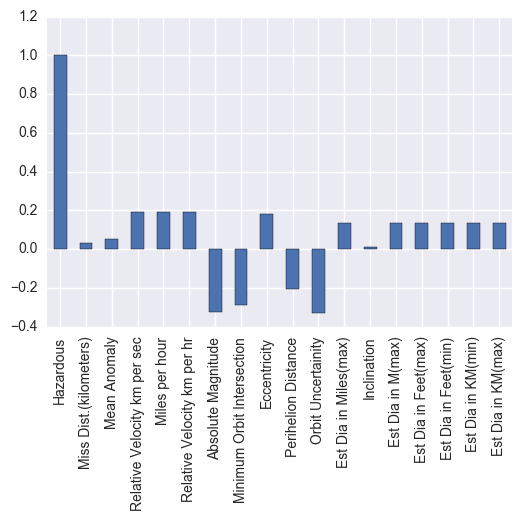

In [236]:
nasa_data_ranked.corr()["Hazardous"].plot(kind="bar")
nasa_data_ranked.corr()["Hazardous"]

In [276]:
# Quick plot of the data using seaborn
sns.pairplot(nasa_data, hue="Hazardous")
sns.plt.show()

In [238]:
X = nasa_data_ranked[ranked_predictors]
#setting target
y = nasa_data_ranked["Hazardous"]

# Part A K Nearest neighbours

In [269]:
knn_k = []
for i in range(0,33):  # try up to k=33
    if (i % 2 != 0): # Use only odd k 
        knn_k.append(i)

cross_vals = []
for k in knn_k:
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn,
                             X_train, 
                             y_train, 
                             cv = 10, 
                             scoring='accuracy')
    cross_vals.append(scores.mean())

MSE = [1 - x for x in cross_vals]
optimal_k = knn_k[MSE.index(min(MSE))]
print("Optimal K is {0}".format(optimal_k))

Optimal K is 7


#### How well does KNN perform?

In [283]:
# setting kNN classifier
knn = KNeighborsClassifier(n_neighbors=7)

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# kNN cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using kNN is %s" %cross_val_score(knn,X,y,cv=10).mean())

# kNN metrics
kNNm = knn.fit(X_train, y_train)

y_pred = kNNm.predict(X_test)
print("Accuracy score using kNN is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using kNN is 0.891831395202
Accuracy score using kNN is 0.885866666667


In [284]:
# different values of k=3
# setting kNN classifier
knn = KNeighborsClassifier(n_neighbors=3)

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# kNN cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using kNN is %s" %cross_val_score(knn,X,y,cv=10).mean())

# kNN metrics
kNNm = knn.fit(X_train, y_train)

y_pred = kNNm.predict(X_test)
print("Accuracy score using kNN is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using kNN is 0.89397041951
Accuracy score using kNN is 0.892266666667


In [285]:
# different values of k=12
# setting kNN classifier
knn = KNeighborsClassifier(n_neighbors=12)

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# kNN cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using kNN is %s" %cross_val_score(knn,X,y,cv=10).mean())

# kNN metrics
kNNm = knn.fit(X_train, y_train)

y_pred = kNNm.predict(X_test)
print("Accuracy score using kNN is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using kNN is 0.886708643673
Accuracy score using kNN is 0.8784


#### How well does the KNN classifier perform?
The accuracy of the model ranges between 88 to 90%. 

#### Varying the values of k doesnot change the accuracy of the model a lot.

# Part B Decision Trees

In [277]:
#Decision Tree classifier

DTm = DecisionTreeClassifier()
                                
#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# Decision Tree cross validation

Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)

print("KfoldCrossVal mean score using Decision Tree is %s" %cross_val_score(DTm,X,y,cv=10).mean())

# Decision Tree metrics
sm = DTm.fit(X_train, y_train)

y_pred = sm.predict(X_test)
print("Accuracy score using Decision Tree is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using Decision Tree is 0.9961606743
Accuracy score using Decision Tree is 0.9936


#### How well does the decision tree classifier perform?
Decision tree performed amazingly well with an accuracy of 99%

#### Does the size of the data set make a difference?
No, not much of a difference

#### Do random forests make a difference?

### Random Forest

In [272]:
# Random Forest classifier

RFm = RandomForestClassifier(random_state = 42, 
                                criterion='gini',
                                n_estimators = 500,
                                max_features = 5)
                                
#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# Random Forest cross validation

Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)

print("KfoldCrossVal mean score using Random Forest is %s" %cross_val_score(RFm,X,y,cv=10).mean())

# Random Forest metrics
sm = RFm.fit(X_train, y_train)

y_pred = sm.predict(X_test)
print("Accuracy score using Random Forest is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using Random Forest is 0.994881350786
Accuracy score using Random Forest is 0.994133333333


#### Random forests performed slightly less than decision trees

# Part C Naive bayes

In [240]:
# setting Naive Bayes classifier
nb = MultinomialNB()

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# Naive Bayes cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using Naive Bayes is %s" %cross_val_score(nb,X,y,cv=10).mean())

# Naive Bayes metrics
NBm = nb.fit(X_train, y_train)

y_pred = NBm.predict(X_test)
print("Accuracy score using Naive Bayes is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using Naive Bayes is 0.808459103438
Accuracy score using Naive Bayes is 0.813333333333


In [241]:
# setting Naive Bayes classifier
nb = GaussianNB()

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)
94
# Naive Bayes cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using Naive Bayes is %s" %cross_val_score(nb,X,y,cv=10).mean())

# Naive Bayes metrics
NBm = nb.fit(X_train, y_train)

y_pred = NBm.predict(X_test)
print("Accuracy score using Naive Bayes is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using Naive Bayes is 0.939628658981
Accuracy score using Naive Bayes is 0.9424


In [288]:
# setting Naive Bayes classifier
nb = BernoulliNB()

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

# Naive Bayes cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using Naive Bayes is %s" %cross_val_score(nb,X,y,cv=10).mean())

# Naive Bayes metrics
NBm = nb.fit(X_train, y_train)

y_pred = NBm.predict(X_test)
print("Accuracy score using Naive Bayes is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using Naive Bayes is 0.838276726802
Accuracy score using Naive Bayes is 0.836266666667


#### How well does the naive Bayes classifier perform?
Accuracy of the Naive Bayes classifier depends a lot on the type of the classifier. Highest accuracy comes with GaussianNB followed by Bernoulli and Multinomial.


#### I will prefer GaussianNB as it is highly accurate

# Part D Support Vector Machines

#### Non linear Support Vector Machines

In [244]:
#setting svm classifier kernel=linear
svc = svm.SVC(kernel='linear', C=1).fit(X, y)

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

#SVM cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using SVM is %s" %cross_val_score(svc,X,y,cv=10).mean())
#SVM metrics
sm = svc.fit(X_train, y_train)
y_pred = sm.predict(X_test)
print("Accuracy score using SVM is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using SVM is 0.941762673655
Accuracy score using SVM is 0.9392


In [274]:
#setting svm classifier kernel=poly
svc = svm.SVC(kernel='poly', C=1).fit(X, y)

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

#SVM cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using SVM is %s" %cross_val_score(svc,X,y,cv=10).mean())
#SVM metrics
sm = svc.fit(X_train, y_train)
y_pred = sm.predict(X_test)
print("Accuracy score using SVM is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using SVM is 0.838917296845
Accuracy score using SVM is 0.837333333333


In [275]:
#setting svm classifier kernel=svf
svc = svm.SVC(kernel='rbf', C=1).fit(X, y)

#dividing data to have a training and a testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .4, random_state=0)

#SVM cross validation
Kfold = KFold(len(nasa_data_ranked), n_folds=5, shuffle=False)
print("KfoldCrossVal mean score using SVM is %s" %cross_val_score(svc,X,y,cv=10).mean())
#SVM metrics
sm = svc.fit(X_train, y_train)
y_pred = sm.predict(X_test)
print("Accuracy score using SVM is %s" %metrics.accuracy_score(y_test, y_pred))

KfoldCrossVal mean score using SVM is 0.890978039814
Accuracy score using SVM is 0.855466666667


#### How well does the SVM classifier perform?
The accuracy of the model varies hugely between 83 and 94%
#### After trying various kernel values, linear has the highest accuracy.

In [ ]:
Which of the methods (k-Nearest Neighbors, decision trees, naive Bayes and support vector machines) did the best? Why

# Part E Comparison of all four parts

Which of the methods (k-Nearest Neighbors, decision trees, naive Bayes and support vector machines) did the best? Why?

| Classifier    | Accuracy(%)|
|-------------- |------------|
|      KNN      | 89         |
|Decision Trees | 99         |
|  Naive Bayes  | 94         |
|  SVM          | 94         |

#### Decision Trees have the highest accuracy.